# **WebScrapping of NOAA website for Storm Events Database**

Install required Libraries.

In [ ]:
!pip install selenium

     |████████████████████████████████| 904 kB 5.2 MB/s 


In [ ]:
!pip install kora -q

     |████████████████████████████████| 57 kB 2.9 MB/s 
     |████████████████████████████████| 56 kB 3.4 MB/s 


In [ ]:
!pip install beautifulsoup4

In [ ]:
!pip install -U pandas-profiling

     |████████████████████████████████| 261 kB 5.0 MB/s 
     |████████████████████████████████| 3.1 MB 33.5 MB/s 
     |████████████████████████████████| 102 kB 9.6 MB/s 
     |████████████████████████████████| 62 kB 786 kB/s 
     |████████████████████████████████| 10.1 MB 44.0 MB/s 
     |████████████████████████████████| 675 kB 44.3 MB/s 
     |████████████████████████████████| 636 kB 55.5 MB/s 
     |████████████████████████████████| 812 kB 57.9 MB/s 
     |████████████████████████████████| 28.5 MB 48 kB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=f87694c366926e03d4a8b6e9797e90bfd30a8bd17e4405cdaa6f53a47774a52c
  Stored in directory: /root/.cache/pip/wheels/70/e1/52/5b14d250ba868768823940c3229e9950d201a26d0bd3ee8655
  Created wheel for imagehash: filename=ImageHash-4.2.1-py2.py3-none-any.whl size=295207 sha256=657d97cba1b4b1445ca2b450f434ea948002865eafbea3a38c9a27e4721e8131
  Stored in directory: /root/.cache/pip/wheels/4c/d5/59/5e3e2

In [ ]:
pip install great_expectations==0.13

     |████████████████████████████████| 4.5 MB 5.1 MB/s 
     |████████████████████████████████| 148 kB 67.8 MB/s 
     |████████████████████████████████| 58 kB 5.2 MB/s 
     |████████████████████████████████| 109 kB 72.5 MB/s 
     |████████████████████████████████| 743 kB 54.0 MB/s 
     |████████████████████████████████| 747 kB 57.6 MB/s 
     |████████████████████████████████| 546 kB 47.9 MB/s 
  Attempting uninstall: typing-extensions
    Found existing installation: typing-extensions 3.7.4.3
    Uninstalling typing-extensions-3.7.4.3:
      Successfully uninstalled typing-extensions-3.7.4.3
  Attempting uninstall: regex
    Found existing installation: regex 2019.12.20
    Uninstalling regex-2019.12.20:
      Successfully uninstalled regex-2019.12.20
  Attempting uninstall: requests
    Found existing installation: requests 2.26.0
    Uninstalling requests-2.26.0:
      Successfully uninstalled requests-2.26.0
ERROR: pip's dependency resolver does not currently take into account

In [ ]:
pip install google-cloud-storage

Import the libraries.

In [ ]:
import pandas as pd
import selenium
import requests
import urllib.request
import gzip
# from selenium import webdriver
# from kora.selenium import wd
import numpy as np

In [ ]:
import requests
import bs4 as soup

In [ ]:
import re

In [ ]:
import os

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import gzip
from matplotlib.pyplot import figure
%matplotlib inline


Send request to the NOAA Url----(Requests will allow you to send HTTP/1.1 requests using Python)

In [ ]:
resp = requests.get("https://www.ncei.noaa.gov/pub/data/swdi/stormevents/csvfiles/",)

Extract Data in form of text using BeautifulSoup----(useful for paring a webpage)

In [ ]:
links = soup.BeautifulSoup(resp.text)

In [ ]:
links

<!DOCTYPE HTML PUBLIC "-//W3C//DTD HTML 3.2 Final//EN">
<html>
<head>
<title>Index of /pub/data/swdi/stormevents/csvfiles</title>
</head>
<body>
<h1>Index of /pub/data/swdi/stormevents/csvfiles</h1>
<table>
<tr><th><a href="?C=N;O=D">Name</a></th><th><a href="?C=M;O=A">Last modified</a></th><th><a href="?C=S;O=A">Size</a></th><th><a href="?C=D;O=A">Description</a></th></tr>
<tr><th colspan="4"><hr/></th></tr>
<tr><td><a href="/pub/data/swdi/stormevents/">Parent Directory</a></td><td> </td><td align="right">  - </td><td> </td></tr>
<tr><td><a href="Storm-Data-Bulk-csv-Format.pdf">Storm-Data-Bulk-csv-Format.pdf</a></td><td align="right">2020-07-17 13:10  </td><td align="right">161K</td><td> </td></tr>
<tr><td><a href="Storm-Data-Export-Format.pdf">Storm-Data-Export-Format.pdf</a></td><td align="right">2020-07-17 09:17  </td><td align="right">163K</td><td> </td></tr>
<tr><td><a href="StormEvents_details-ftp_v1.0_d1950_c20210803.csv.gz">StormEvents_details-ftp_v1.0_d1950_c20210803.csv.gz</

Made a list named csvs to store all the CSV's name present on the page.

In [ ]:
csvs = []
for tag in links.find_all("tr"):
  text = tag.text
  if ".csv.gz" in text:
    text = text.split(".gz")[0]
    csvs.append(text + ".gz")

In [ ]:
csvs

['StormEvents_details-ftp_v1.0_d1950_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1951_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1952_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1953_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1954_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1955_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1956_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1957_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1958_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1959_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1960_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1961_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1962_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1963_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1964_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1965_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1966_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d1967_c20210803.c

Made a list of years called list_years for which the informations needs to be extracted.

In [ ]:
list_year=['d'+str(2017+i) for i in range(5)] #only analyzing 2017-2021
list_year

['d2017', 'd2018', 'd2019', 'd2020', 'd2021']

Filter out the CSV's name we require in accordance with list_years in df1 list.

In [ ]:
df1 = [csvs[i] for i in range(len(csvs)) if csvs[i][-22:-17] in list_year ]
df1
# for j in range(len(csvs)):
#   for i in range(len(list_year)):
#     if (str(list_year[i])) in str(csvs[j]) :
#       df1.append(csvs[j])
    # df1.append(csvs[j]str.contains(str(list_year[i]))])

['StormEvents_details-ftp_v1.0_d2017_c20210923.csv.gz',
 'StormEvents_details-ftp_v1.0_d2018_c20210817.csv.gz',
 'StormEvents_details-ftp_v1.0_d2019_c20210803.csv.gz',
 'StormEvents_details-ftp_v1.0_d2020_c20210923.csv.gz',
 'StormEvents_details-ftp_v1.0_d2021_c20210923.csv.gz',
 'StormEvents_fatalities-ftp_v1.0_d2017_c20210923.csv.gz',
 'StormEvents_fatalities-ftp_v1.0_d2018_c20210817.csv.gz',
 'StormEvents_fatalities-ftp_v1.0_d2019_c20210803.csv.gz',
 'StormEvents_fatalities-ftp_v1.0_d2020_c20210923.csv.gz',
 'StormEvents_fatalities-ftp_v1.0_d2021_c20210923.csv.gz',
 'StormEvents_locations-ftp_v1.0_d2017_c20210923.csv.gz',
 'StormEvents_locations-ftp_v1.0_d2018_c20210817.csv.gz',
 'StormEvents_locations-ftp_v1.0_d2019_c20210803.csv.gz',
 'StormEvents_locations-ftp_v1.0_d2020_c20210923.csv.gz',
 'StormEvents_locations-ftp_v1.0_d2021_c20210923.csv.gz']

In [ ]:
pwd

'/content'

Define a function called createFolder to create three different folders as Details, Fatalities and Locations

In [ ]:
def createFolder(directory):
    try:
        if not os.path.exists(directory):
            os.makedirs(directory)
    except OSError:
        print ('Error: Creating directory. ' +  directory)

In [ ]:
createFolder('./details/')
createFolder('./fatalities/')
createFolder('./locations/')

1. Split into three categories
2. Request the URLs
3. Unzip the files
4. Read the files
5. Append into respective categories to make Master Dataframe of each category.
6. Save as CSVs

In [ ]:
master_df_details=pd.DataFrame()
master_df_fatalities=pd.DataFrame()
master_df_locations=pd.DataFrame()
for i in range(len(df1)):
  initial_split=df1[i].split("_")[1]
  file_type=initial_split.split("-")[0]
  # print(file_type)
  urllib.request.urlretrieve('https://www.ncei.noaa.gov/pub/data/swdi/stormevents/csvfiles/'+df1[i],
                               '/content/'+file_type+"/"+df1[i])
  f = gzip.open('/content/'+file_type+"/"+df1[i],'rb')
  file_content = pd.read_csv(f)
  if "details" in file_type:
    master_df_details=master_df_details.append(file_content)
    
  if "fatalities" in file_type:
    master_df_fatalities=master_df_fatalities.append(file_content)
  if "locations" in file_type:
    master_df_locations=master_df_locations.append(file_content)
master_df_details.to_csv('master_df_details.csv')
master_df_fatalities.to_csv('master_df_fatalities.csv')
master_df_locations.to_csv('master_df_locations.csv')

In [ ]:
master_df_locations

,YEARMONTH,EPISODE_ID,EVENT_ID,LOCATION_INDEX,RANGE,AZIMUTH,LOCATION,LATITUDE,LONGITUDE,LAT2,LON2
0,201703,112682,673239,1,0.86,SSW,ELKINS,38.9087,-79.8569,3854522,7951414
1,201703,112682,673240,1,0.00,N,(EKN)RANDOLPH FLD EL,38.8800,-79.8500,3852800,7951000
2,201703,112682,673241,1,14.77,WSW,PEELTREE,39.0417,-80.4707,392502,8028242
3,201703,112682,673699,1,2.00,S,GLENVILLE,38.9011,-80.8300,3854066,8049800
4,201703,112681,673155,1,0.60,NNW,LANGSVILLE,39.0577,-82.1854,393462,8211124
...,...,...,...,...,...,...,...,...,...,...,...
23064,202106,160374,970245,3,3.38,WSW,GROESBECK,31.5132,-96.5738,3130792,9634428
23065,202106,160374,970245,4,1.72,SSW,GROESBECK,31.5060,-96.5279,3130360,9631674
23066,202106,160374,970247,1,1.12,ENE,PALESTINE ARPT,31.7788,-95.7139,3146728,9542834
23067,202106,160374,970250,1,1.76,E,PALESTINE,31.7500,-95.6000,3145000,9536000


In [ ]:
master_df_details=pd.read_csv('master_df_details.csv', index_col=0)

In [ ]:
master_df_details

,BEGIN_YEARMONTH,BEGIN_DAY,BEGIN_TIME,END_YEARMONTH,END_DAY,END_TIME,EPISODE_ID,EVENT_ID,STATE,STATE_FIPS,YEAR,MONTH_NAME,EVENT_TYPE,CZ_TYPE,CZ_FIPS,CZ_NAME,WFO,BEGIN_DATE_TIME,CZ_TIMEZONE,END_DATE_TIME,INJURIES_DIRECT,INJURIES_INDIRECT,DEATHS_DIRECT,DEATHS_INDIRECT,DAMAGE_PROPERTY,DAMAGE_CROPS,SOURCE,MAGNITUDE,MAGNITUDE_TYPE,FLOOD_CAUSE,CATEGORY,TOR_F_SCALE,TOR_LENGTH,TOR_WIDTH,TOR_OTHER_WFO,TOR_OTHER_CZ_STATE,TOR_OTHER_CZ_FIPS,TOR_OTHER_CZ_NAME,BEGIN_RANGE,BEGIN_AZIMUTH,BEGIN_LOCATION,END_RANGE,END_AZIMUTH,END_LOCATION,BEGIN_LAT,BEGIN_LON,END_LAT,END_LON,EPISODE_NARRATIVE,EVENT_NARRATIVE,DATA_SOURCE
0,201704,6,1509,201704,6,1509,113355,678791,NEW JERSEY,34,2017,April,Thunderstorm Wind,C,15,GLOUCESTER,PHI,06-APR-17 15:09:00,EST-5,06-APR-17 15:09:00,0,0,0,0,NaN,NaN,Trained Spotter,52.0,EG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NW,FRIES MILLS,1.0,NW,FRIES MILLS,39.6600,-75.0800,39.6600,-75.0800,Low pressure tracked from the Ohio Valley into...,A couple of trees were taken down due to thund...,CSV
1,201704,6,930,201704,6,940,113459,679228,FLORIDA,12,2017,April,Tornado,C,71,LEE,TBW,06-APR-17 09:30:00,EST-5,06-APR-17 09:40:00,1,0,0,0,110.00K,0.00K,Emergency Manager,NaN,NaN,NaN,NaN,EF0,7.43,20.0,NaN,NaN,NaN,NaN,1.0,S,PUNTA RASSA,1.0,SW,FORT MYERS VILLAS,26.5010,-81.9980,26.5339,-81.8836,A line of thunderstorms developed along a pref...,Emergency management reported and broadcast me...,CSV
2,201704,5,1749,201704,5,1753,113448,679268,OHIO,39,2017,April,Thunderstorm Wind,C,57,GREENE,ILN,05-APR-17 17:49:00,EST-5,05-APR-17 17:53:00,0,0,0,0,1.00K,0.00K,Amateur Radio,50.0,EG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,NE,FAIRBORN,3.0,NE,FAIRBORN,39.8500,-83.9900,39.8500,-83.9900,Showers and thunderstorms developed ahead of a...,An entire tree was uprooted in a yard on Dayto...,CSV
3,201704,16,1759,201704,16,1900,113697,682042,OHIO,39,2017,April,Flood,C,25,CLERMONT,ILN,16-APR-17 17:59:00,EST-5,16-APR-17 19:00:00,0,0,0,0,5.00K,0.00K,Public,NaN,NaN,Heavy Rain,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NW,SUMMERSIDE,1.0,NW,SUMMERSIDE,39.1065,-84.2875,39.1061,-84.2874,Thunderstorms with very heavy rain developed a...,Garage of a home was flooded by high water.,CSV
4,201704,15,1550,201704,15,1550,113683,682062,NEBRASKA,31,2017,April,Hail,C,25,CASS,OAX,15-APR-17 15:50:00,CST-6,15-APR-17 15:50:00,0,0,0,0,0.00K,0.00K,Trained Spotter,1.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,ENE,COLE ARPT,2.0,ENE,COLE ARPT,40.9800,-95.8900,40.9800,-95.8900,An upper level storm system moved into Nebrask...,NaN,CSV
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31453,202106,10,934,202106,10,1130,160609,970426,MISSISSIPPI,28,2021,June,Flash Flood,C,27,COAHOMA,MEG,10-JUN-21 09:34:00,CST-6,10-JUN-21 11:30:00,0,0,0,0,150.00K,0.00K,Law Enforcement,NaN,NaN,Heavy Rain,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,N,CLARKSDALE,1.0,SW,LYON,34.2127,-90.5803,34.2089,-90.5596,A stubborn upper low remained stalled across t...,One business and one home were flooded. Ten ro...,CSV
31454,202106,10,509,202106,10,1430,160609,970436,MISSISSIPPI,28,2021,June,Flash Flood,C,135,TALLAHATCHIE,MEG,10-JUN-21 05:09:00,CST-6,10-JUN-21 14:30:00,0,0,0,0,1.30M,0.00K,Emergency Manager,NaN,NaN,Heavy Rain,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,N,TEASDALE,4.0,ESE,CHARLESTON,34.1200,-90.0300,33.9747,-89.9958,A stubborn upper low remained stalled across t...,Over 15 inches of rain resulted in widespread ...,CSV
31455,202106,10,500,202106,10,1200,160609,970424,MISSISSIPPI,28,2021,June,Flash Flood,C,119,QUITMAN,MEG,10-JUN-21 05:00:00,CST-6,10-JUN-21 12:00:00,0,0,0,0,700.00K,0.00K,Emergency Manager,NaN,NaN,Heavy Rain,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NNE,SLEDGE,1.0,NE,NEELS FERRY,34.4496,-90.2059,34.4293,-90.2881,A stubborn upper low remained stalled across t...,Heavy rain resulted in flash flooding across Q...,CSV
31456,202106,21,1514,202106,21,1514,158191,95630

## Intial EDA

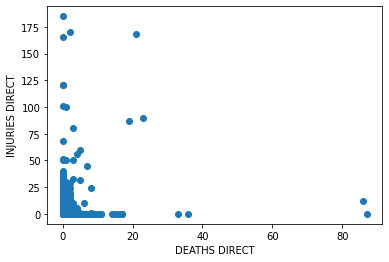

<Figure size 640x480 with 0 Axes>

In [ ]:
# Add title and axis names
plt.xlabel('DEATHS DIRECT')
plt.ylabel('INJURIES DIRECT')

#plot the scatter plot of Month and Magnitude variable in data
plt.scatter(master_df_details.DEATHS_DIRECT,master_df_details.INJURIES_DIRECT)
figure(figsize=(8, 6), dpi=80)
plt.show()

In [ ]:
import plotly.graph_objects as go

size = master_df_details.DEATHS_DIRECT
fig = go.Figure(data=[go.Scatter(
    x=master_df_details.STATE,
    y=master_df_details.EVENT_TYPE,
    mode='markers',
    marker=dict(
        size=size,
        sizemode='area',
        sizeref=2.*max(size)/(40.**2),
        sizemin=4
    )
)])

fig.show()

In [ ]:
import plotly.graph_objects as go

size = master_df_details.DEATHS_DIRECT
fig = go.Figure(data=[go.Scatter(
    x=master_df_details.YEAR,
    y=master_df_details.EVENT_TYPE,
    mode='markers',
    marker=dict(
        size=size,
        sizemode='area',
        sizeref=2.*max(size)/(40.**2),
        sizemin=4
    )
)])

fig.show()

Text(0, 0.5, 'DEATHS DIRECT')

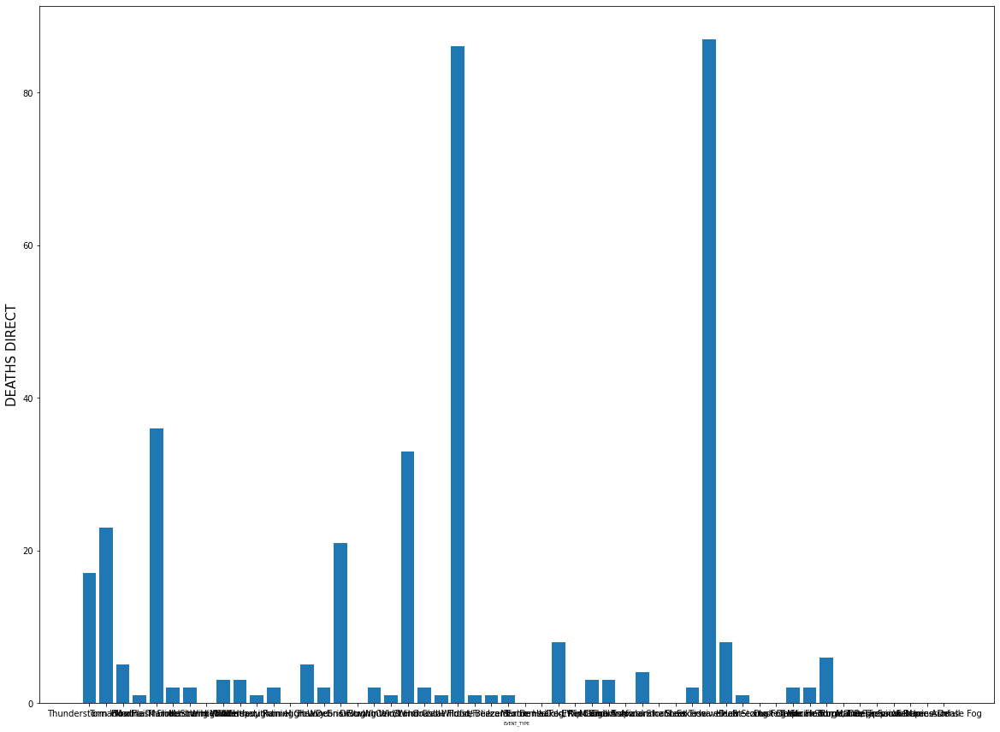

In [ ]:
plt.figure(figsize=(20,15))
# bar plot with matplotlib
plt.bar('EVENT_TYPE', 'DEATHS_DIRECT',data=master_df_details)
plt.xlabel("EVENT_TYPE", size=5)
plt.ylabel("DEATHS DIRECT", size=15)
# plt.title("Bar plot in Ascending Order with Matplotlib", size=18)

In [ ]:
master_df_fatalities

,FAT_YEARMONTH,FAT_DAY,FAT_TIME,FATALITY_ID,EVENT_ID,FATALITY_TYPE,FATALITY_DATE,FATALITY_AGE,FATALITY_SEX,FATALITY_LOCATION,EVENT_YEARMONTH
0,201706,30,0,33428,700794,I,06/30/2017 00:00:00,NaN,F,Permanent Home,201706.0
1,201706,20,0,33580,702637,D,06/20/2017 00:00:00,NaN,M,Mobile/Trailer Home,201706.0
2,201706,17,0,33579,702637,D,06/17/2017 00:00:00,NaN,M,Under Tree,201706.0
3,201706,6,0,33512,707166,D,06/06/2017 00:00:00,56.0,F,Outside/Open Areas,201706.0
4,201706,3,0,33513,707167,D,06/03/2017 00:00:00,39.0,M,Outside/Open Areas,201706.0
...,...,...,...,...,...,...,...,...,...,...,...
506,202101,3,0,42360,932613,D,01/03/2021 00:00:00,40.0,M,In Water,202101.0
507,202101,10,0,42361,932614,D,01/10/2021 00:00:00,NaN,F,In Water,202101.0
508,202101,10,0,42362,932615,D,01/10/2021 00:00:00,NaN,M,In Water,202101.0
509,202101,18,0,42364,932626,D,01/18/2021 00:00:00,12.0,M,In Water,202101.0


In [ ]:
master_df_details["EVENT_TYPE"].unique()

array(['Thunderstorm Wind', 'Tornado', 'Flood', 'Hail', 'Flash Flood',
       'Marine Thunderstorm Wind', 'Marine Strong Wind',
       'Marine High Wind', 'Winter Weather', 'Waterspout', 'Heavy Rain',
       'Lightning', 'Funnel Cloud', 'High Wind', 'Heavy Snow',
       'Debris Flow', 'Drought', 'Strong Wind', 'Winter Storm',
       'Cold/Wind Chill', 'Hurricane', 'Coastal Flood', 'Wildfire',
       'Frost/Freeze', 'Blizzard', 'Ice Storm', 'Marine Hail',
       'Dense Fog', 'Extreme Cold/Wind Chill', 'Lake-Effect Snow',
       'Rip Current', 'High Surf', 'Marine Tropical Storm', 'Avalanche',
       'Astronomical Low Tide', 'Sleet', 'Sneakerwave', 'Excessive Heat',
       'Heat', 'Dust Storm', 'Freezing Fog', 'Dust Devil',
       'Lakeshore Flood', 'Tropical Storm', 'Storm Surge/Tide',
       'Marine Hurricane/Typhoon', 'Tropical Depression', 'Dense Smoke',
       'Marine Tropical Depression', 'Seiche', 'Volcanic Ashfall',
       'Marine Dense Fog'], dtype=object)

# Pandas Profiling

Pandas profiling is an open source Python module with which we can quickly do an exploratory data analysis.

In [ ]:
from pandas_profiling import ProfileReport

report = ProfileReport(master_df_details, minimal=True)

print(repr(report.report))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Root


In [ ]:
from IPython.display import display,HTML,IFrame

report.to_file(output_file='details.html')
display(HTML(open('details.html').read()))

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Number of variables,52
Number of observations,279583
Missing cells,3961619
Missing cells (%),27.2%
Total size in memory,110.9 MiB
Average record size in memory,416.0 B
Numeric,27
Categorical,25
"DATA_SOURCE has constant value ""CSV""",Constant
STATE has a high cardinality: 67 distinct values,High cardinality
EVENT_TYPE has a high cardinality: 52 distinct values,High cardinality


In [ ]:
from pandas_profiling import ProfileReport

report = ProfileReport(master_df_fatalities)

print(repr(report.report))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Root


In [ ]:
from IPython.display import display,HTML,IFrame

report.to_file(output_file='fatalities.html')
display(HTML(open('fatalities.html').read()))

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Number of variables,12
Number of observations,3529
Missing cells,1499
Missing cells (%),3.5%
Duplicate rows,0
Duplicate rows (%),0.0%
Total size in memory,331.0 KiB
Average record size in memory,96.0 B
Numeric,7
Categorical,5
"FAT_TIME has constant value ""0""",Constant


In [ ]:
from pandas_profiling import ProfileReport

report = ProfileReport(master_df_locations)

print(repr(report.report))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/scipy/stats/stats.py:4812: RuntimeWarning: overflow encountered in long_scalars
  (2 * xtie * ytie) / m + x0 * y0 / (9 * m * (size - 2)))


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Root


In [ ]:
from IPython.display import display,HTML,IFrame

report.to_file(output_file='locations.html')
display(HTML(open('locations.html').read()))

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Number of variables,12
Number of observations,212968
Missing cells,0
Missing cells (%),0.0%
Duplicate rows,0
Duplicate rows (%),0.0%
Total size in memory,19.5 MiB
Average record size in memory,96.0 B
Numeric,10
Categorical,2
LOCATION has a high cardinality: 32482 distinct values,High cardinality


## Data Validation Using Great Expectations library

In [ ]:
## Setup required for great expectations
%%bash
if [[ ! -d great_expectations ]]
then 
  git init
  git remote add origin https://github.com/datarootsio/tutorial-great-expectations.git
  git pull origin main
  pip install great_expectations==0.13
  apt-get install tree
  mkdir -p great_expectations/checkpoints
fi

Initialized empty Git repository in /content/.git/
Reading package lists...
Building dependency tree...
Reading state information...
The following NEW packages will be installed:
  tree
0 upgraded, 1 newly installed, 0 to remove and 37 not upgraded.
Need to get 40.7 kB of archives.
After this operation, 105 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tree amd64 1.7.0-5 [40.7 kB]
Fetched 40.7 kB in 0s (89.5 kB/s)
Selecting previously unselected package tree.
(Reading database ... 155047 files and directories currently installed.)
Preparing to unpack .../tree_1.7.0-5_amd64.deb ...
Unpacking tree (1.7.0-5) ...
Setting up tree (1.7.0-5) ...
Processing triggers for man-db (2.8.3-2ubuntu0.1) ...


From https://github.com/datarootsio/tutorial-great-expectations
 * branch            main       -> FETCH_HEAD
 * [new branch]      main       -> origin/main


In [ ]:
import great_expectations as ge
context = ge.data_context.DataContext()

In [ ]:
suite = context.create_expectation_suite(
    'check_details',
    overwrite_existing=True
)

In [ ]:
batch_kwargs = {
    'path': '/content/master_df_details.csv',
    'datasource': 'data_dir',
    'data_asset_name': 'master_df_details',
    'reader_method': 'read_csv',
    'reader_options': {
        'index_col': 0,
    }
}
batch = context.get_batch(batch_kwargs, suite)

In [ ]:
batch.head()

,BEGIN_YEARMONTH,BEGIN_DAY,BEGIN_TIME,END_YEARMONTH,END_DAY,END_TIME,EPISODE_ID,EVENT_ID,STATE,STATE_FIPS,YEAR,MONTH_NAME,EVENT_TYPE,CZ_TYPE,CZ_FIPS,CZ_NAME,WFO,BEGIN_DATE_TIME,CZ_TIMEZONE,END_DATE_TIME,INJURIES_DIRECT,INJURIES_INDIRECT,DEATHS_DIRECT,DEATHS_INDIRECT,DAMAGE_PROPERTY,DAMAGE_CROPS,SOURCE,MAGNITUDE,MAGNITUDE_TYPE,FLOOD_CAUSE,CATEGORY,TOR_F_SCALE,TOR_LENGTH,TOR_WIDTH,TOR_OTHER_WFO,TOR_OTHER_CZ_STATE,TOR_OTHER_CZ_FIPS,TOR_OTHER_CZ_NAME,BEGIN_RANGE,BEGIN_AZIMUTH,BEGIN_LOCATION,END_RANGE,END_AZIMUTH,END_LOCATION,BEGIN_LAT,BEGIN_LON,END_LAT,END_LON,EPISODE_NARRATIVE,EVENT_NARRATIVE,DATA_SOURCE
0,201704,6,1509,201704,6,1509,113355,678791,NEW JERSEY,34,2017,April,Thunderstorm Wind,C,15,GLOUCESTER,PHI,06-APR-17 15:09:00,EST-5,06-APR-17 15:09:00,0,0,0,0,NaN,NaN,Trained Spotter,52.0,EG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NW,FRIES MILLS,1.0,NW,FRIES MILLS,39.6600,-75.0800,39.6600,-75.0800,Low pressure tracked from the Ohio Valley into...,A couple of trees were taken down due to thund...,CSV
1,201704,6,930,201704,6,940,113459,679228,FLORIDA,12,2017,April,Tornado,C,71,LEE,TBW,06-APR-17 09:30:00,EST-5,06-APR-17 09:40:00,1,0,0,0,110.00K,0.00K,Emergency Manager,NaN,NaN,NaN,NaN,EF0,7.43,20.0,NaN,NaN,NaN,NaN,1.0,S,PUNTA RASSA,1.0,SW,FORT MYERS VILLAS,26.5010,-81.9980,26.5339,-81.8836,A line of thunderstorms developed along a pref...,Emergency management reported and broadcast me...,CSV
2,201704,5,1749,201704,5,1753,113448,679268,OHIO,39,2017,April,Thunderstorm Wind,C,57,GREENE,ILN,05-APR-17 17:49:00,EST-5,05-APR-17 17:53:00,0,0,0,0,1.00K,0.00K,Amateur Radio,50.0,EG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,NE,FAIRBORN,3.0,NE,FAIRBORN,39.8500,-83.9900,39.8500,-83.9900,Showers and thunderstorms developed ahead of a...,An entire tree was uprooted in a yard on Dayto...,CSV
3,201704,16,1759,201704,16,1900,113697,682042,OHIO,39,2017,April,Flood,C,25,CLERMONT,ILN,16-APR-17 17:59:00,EST-5,16-APR-17 19:00:00,0,0,0,0,5.00K,0.00K,Public,NaN,NaN,Heavy Rain,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NW,SUMMERSIDE,1.0,NW,SUMMERSIDE,39.1065,-84.2875,39.1061,-84.2874,Thunderstorms with very heavy rain developed a...,Garage of a home was flooded by high water.,CSV
4,201704,15,1550,201704,15,1550,113683,682062,NEBRASKA,31,2017,April,Hail,C,25,CASS,OAX,15-APR-17 15:50:00,CST-6,15-APR-17 15:50:00,0,0,0,0,0.00K,0.00K,Trained Spotter,1.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,ENE,COLE ARPT,2.0,ENE,COLE ARPT,40.9800,-95.8900,40.9800,-95.8900,An upper level storm system moved into Nebrask...,NaN,CSV


In [ ]:
#Check primary keys for nulls
batch.expect_column_values_to_not_be_null('EVENT_ID')

{
  "meta": {},
  "exception_info": null,
  "result": {
    "element_count": 279583,
    "unexpected_count": 0,
    "unexpected_percent": 0.0,
    "partial_unexpected_list": []
  },
  "expectation_config": {
    "kwargs": {
      "column": "EVENT_ID",
      "result_format": "BASIC"
    },
    "expectation_type": "expect_column_values_to_not_be_null",
    "meta": {}
  },
  "success": true
}

In [ ]:
#Check State field for consistency in data type
batch.expect_column_values_to_be_of_type('STATE', 'str')

{
  "meta": {},
  "exception_info": null,
  "result": {
    "element_count": 279583,
    "missing_count": 0,
    "missing_percent": 0.0,
    "unexpected_count": 0,
    "unexpected_percent": 0.0,
    "unexpected_percent_nonmissing": 0.0,
    "partial_unexpected_list": []
  },
  "expectation_config": {
    "kwargs": {
      "column": "STATE",
      "type_": "str",
      "result_format": "BASIC"
    },
    "expectation_type": "_expect_column_values_to_be_of_type__map",
    "meta": {}
  },
  "success": true
}

In [ ]:
#Validate date column for format
batch.expect_column_values_to_be_dateutil_parseable('BEGIN_DATE_TIME')

{
  "meta": {},
  "exception_info": null,
  "result": {
    "element_count": 279583,
    "missing_count": 0,
    "missing_percent": 0.0,
    "unexpected_count": 0,
    "unexpected_percent": 0.0,
    "unexpected_percent_nonmissing": 0.0,
    "partial_unexpected_list": []
  },
  "expectation_config": {
    "kwargs": {
      "column": "BEGIN_DATE_TIME",
      "result_format": "BASIC"
    },
    "expectation_type": "expect_column_values_to_be_dateutil_parseable",
    "meta": {}
  },
  "success": true
}

In [ ]:
#Checking day values to be within range
batch.expect_column_values_to_be_between('BEGIN_DAY', min_value=1, max_value=31)

{
  "meta": {},
  "exception_info": null,
  "result": {
    "element_count": 279583,
    "missing_count": 0,
    "missing_percent": 0.0,
    "unexpected_count": 0,
    "unexpected_percent": 0.0,
    "unexpected_percent_nonmissing": 0.0,
    "partial_unexpected_list": []
  },
  "expectation_config": {
    "kwargs": {
      "column": "BEGIN_DAY",
      "min_value": 1,
      "max_value": 31,
      "result_format": "BASIC"
    },
    "expectation_type": "expect_column_values_to_be_between",
    "meta": {}
  },
  "success": true
}

In [ ]:
#Checking categorical variable CZ_TYPE to be one of the three values
batch.expect_column_distinct_values_to_be_in_set('CZ_TYPE', ['C','Z','M'])

{
  "meta": {},
  "exception_info": null,
  "result": {
    "observed_value": [
      "C",
      "Z"
    ],
    "element_count": 279583,
    "missing_count": null,
    "missing_percent": null
  },
  "expectation_config": {
    "kwargs": {
      "column": "CZ_TYPE",
      "value_set": [
        "C",
        "Z",
        "M"
      ],
      "result_format": "BASIC"
    },
    "expectation_type": "expect_column_distinct_values_to_be_in_set",
    "meta": {}
  },
  "success": true
}

In [ ]:
batch.save_expectation_suite()

In [ ]:
!tree great_expectations -nI "uncommitted"

great_expectations
├── checkpoints
├── expectations
│   └── check_details.json
├── great_expectations.yml
├── notebooks
│   ├── pandas
│   │   └── validation_playground.ipynb
│   ├── spark
│   │   └── validation_playground.ipynb
│   └── sql
│       └── validation_playground.ipynb
└── plugins
    └── custom_data_docs
        └── styles
            └── data_docs_custom_styles.css

9 directories, 6 files


In [ ]:
#View json file with expectations
!cat great_expectations/expectations/check_details.json

{
  "data_asset_type": "Dataset",
  "expectation_suite_name": "check_details",
  "expectations": [
    {
      "expectation_type": "expect_column_values_to_not_be_null",
      "kwargs": {
        "column": "EVENT_ID"
      },
      "meta": {}
    },
    {
      "expectation_type": "expect_column_values_to_be_of_type",
      "kwargs": {
        "column": "STATE",
        "type_": "str"
      },
      "meta": {}
    },
    {
      "expectation_type": "expect_column_values_to_be_dateutil_parseable",
      "kwargs": {
        "column": "BEGIN_DATE_TIME"
      },
      "meta": {}
    },
    {
      "expectation_type": "expect_column_values_to_be_between",
      "kwargs": {
        "column": "BEGIN_DAY",
        "max_value": 31,
        "min_value": 1
      },
      "meta": {}
    },
    {
      "expectation_type": "expect_column_distinct_values_to_be_in_set",
      "kwargs": {
        "column": "CZ_TYPE",
        "value_set": [
          "C",
          "Z",
          "M"
        ]
      },


In [ ]:
#store results of expectations
results = context.run_validation_operator('my_validation_operator', assets_to_validate=[batch])

In [ ]:
results

{
  "run_results": {
    "ValidationResultIdentifier::check_details/20211001T185957.280201Z/20211001T185957.280201Z/8ce00cd6498690b07329a11b93d27059": {
      "validation_result": {
        "meta": {
          "great_expectations_version": "0.13.0",
          "expectation_suite_name": "check_details",
          "run_id": {
            "run_name": "20211001T185957.280201Z",
            "run_time": "2021-10-01T18:59:57.280201+00:00"
          },
          "batch_kwargs": {
            "path": "/content/master_df_details.csv",
            "datasource": "data_dir",
            "data_asset_name": "master_df_details",
            "reader_method": "read_csv",
            "reader_options": {
              "index_col": 0
            }
          },
          "batch_markers": {
            "ge_load_time": "20211001T184559.437372Z",
            "pandas_data_fingerprint": "d9f64c27c6ebb22e05c9e5229e6d17a4"
          },
          "batch_parameters": null,
          "validation_time": "20211001T18595

In [ ]:
#Create expectations for fatalities file
suite = context.create_expectation_suite(
    'check_fatalities',
    overwrite_existing=True
)

In [ ]:
batch_kwargs = {
    'path': '/content/master_df_fatalities.csv',
    'datasource': 'data_dir',
    'data_asset_name': 'master_df_fatalities',
    'reader_method': 'read_csv',
    'reader_options': {
        'index_col': 0,
    }
}
batch = context.get_batch(batch_kwargs, suite)

In [ ]:
batch.head()

,FAT_YEARMONTH,FAT_DAY,FAT_TIME,FATALITY_ID,EVENT_ID,FATALITY_TYPE,FATALITY_DATE,FATALITY_AGE,FATALITY_SEX,FATALITY_LOCATION,EVENT_YEARMONTH
0,201706,30,0,33428,700794,I,06/30/2017 00:00:00,NaN,F,Permanent Home,201706.0
1,201706,20,0,33580,702637,D,06/20/2017 00:00:00,NaN,M,Mobile/Trailer Home,201706.0
2,201706,17,0,33579,702637,D,06/17/2017 00:00:00,NaN,M,Under Tree,201706.0
3,201706,6,0,33512,707166,D,06/06/2017 00:00:00,56.0,F,Outside/Open Areas,201706.0
4,201706,3,0,33513,707167,D,06/03/2017 00:00:00,39.0,M,Outside/Open Areas,201706.0


In [ ]:
#Validate datatype of Location field
batch.expect_column_values_to_be_of_type('FATALITY_LOCATION', 'str')

{
  "meta": {},
  "exception_info": null,
  "result": {
    "element_count": 3529,
    "missing_count": 0,
    "missing_percent": 0.0,
    "unexpected_count": 0,
    "unexpected_percent": 0.0,
    "unexpected_percent_nonmissing": 0.0,
    "partial_unexpected_list": []
  },
  "expectation_config": {
    "kwargs": {
      "column": "FATALITY_LOCATION",
      "type_": "str",
      "result_format": "BASIC"
    },
    "expectation_type": "_expect_column_values_to_be_of_type__map",
    "meta": {}
  },
  "success": true
}

In [ ]:
#Validate the categorical variable Fatality_Type
batch.expect_column_distinct_values_to_be_in_set('FATALITY_TYPE', ['D','I'])

{
  "meta": {},
  "exception_info": null,
  "result": {
    "observed_value": [
      "D",
      "I"
    ],
    "element_count": 3529,
    "missing_count": null,
    "missing_percent": null
  },
  "expectation_config": {
    "kwargs": {
      "column": "FATALITY_TYPE",
      "value_set": [
        "D",
        "I"
      ],
      "result_format": "BASIC"
    },
    "expectation_type": "expect_column_distinct_values_to_be_in_set",
    "meta": {}
  },
  "success": true
}

In [ ]:
#Validate Fatality_Sex type
batch.expect_column_distinct_values_to_be_in_set('FATALITY_SEX', ['M','F'])

{
  "meta": {},
  "exception_info": null,
  "result": {
    "observed_value": [
      "F",
      "M"
    ],
    "element_count": 3529,
    "missing_count": 618,
    "missing_percent": 17.512043071691696
  },
  "expectation_config": {
    "kwargs": {
      "column": "FATALITY_SEX",
      "value_set": [
        "M",
        "F"
      ],
      "result_format": "BASIC"
    },
    "expectation_type": "expect_column_distinct_values_to_be_in_set",
    "meta": {}
  },
  "success": true
}

In [ ]:
#Validate date field format
batch.expect_column_values_to_be_dateutil_parseable(column='FATALITY_DATE')

{
  "meta": {},
  "exception_info": null,
  "result": {
    "element_count": 3529,
    "missing_count": 0,
    "missing_percent": 0.0,
    "unexpected_count": 0,
    "unexpected_percent": 0.0,
    "unexpected_percent_nonmissing": 0.0,
    "partial_unexpected_list": []
  },
  "expectation_config": {
    "kwargs": {
      "column": "FATALITY_DATE",
      "result_format": "BASIC"
    },
    "expectation_type": "expect_column_values_to_be_dateutil_parseable",
    "meta": {}
  },
  "success": true
}

In [ ]:
batch.save_expectation_suite()

In [ ]:
#View json file with expectations
!cat great_expectations/expectations/check_fatalities.json

{
  "data_asset_type": "Dataset",
  "expectation_suite_name": "check_fatalities",
  "expectations": [
    {
      "expectation_type": "expect_column_values_to_be_of_type",
      "kwargs": {
        "column": "FATALITY_LOCATION",
        "type_": "str"
      },
      "meta": {}
    },
    {
      "expectation_type": "expect_column_distinct_values_to_be_in_set",
      "kwargs": {
        "column": "FATALITY_TYPE",
        "value_set": [
          "D",
          "I"
        ]
      },
      "meta": {}
    },
    {
      "expectation_type": "expect_column_distinct_values_to_be_in_set",
      "kwargs": {
        "column": "FATALITY_SEX",
        "value_set": [
          "M",
          "F"
        ]
      },
      "meta": {}
    },
    {
      "expectation_type": "expect_column_values_to_be_dateutil_parseable",
      "kwargs": {
        "column": "FATALITY_DATE"
      },
      "meta": {}
    }
  ],
  "meta": {
    "great_expectations_version": "0.13.0"
  }
}

In [ ]:
#store results of expectations
results = context.run_validation_operator('my_validation_operator', assets_to_validate=[batch])
results

{
  "run_results": {
    "ValidationResultIdentifier::check_fatalities/20211001T190543.531081Z/20211001T190543.531081Z/fbd705279e859220687d23e66279a988": {
      "validation_result": {
        "meta": {
          "great_expectations_version": "0.13.0",
          "expectation_suite_name": "check_fatalities",
          "run_id": {
            "run_name": "20211001T190543.531081Z",
            "run_time": "2021-10-01T19:05:43.531081+00:00"
          },
          "batch_kwargs": {
            "path": "/content/master_df_fatalities.csv",
            "datasource": "data_dir",
            "data_asset_name": "master_df_fatalities",
            "reader_method": "read_csv",
            "reader_options": {
              "index_col": 0
            }
          },
          "batch_markers": {
            "ge_load_time": "20211001T190130.600750Z",
            "pandas_data_fingerprint": "875f5a25d06df071c3ec882c045a79f8"
          },
          "batch_parameters": null,
          "validation_time": "20

In [ ]:
#Create expectations for Locations file
suite = context.create_expectation_suite(
    'check_locations',
    overwrite_existing=True
)

In [ ]:
batch_kwargs = {
    'path': '/content/master_df_locations.csv',
    'datasource': 'data_dir',
    'data_asset_name': 'master_df_locations',
    'reader_method': 'read_csv',
    'reader_options': {
        'index_col': 0,
    }
}
batch = context.get_batch(batch_kwargs, suite)

In [ ]:
batch.head()

,YEARMONTH,EPISODE_ID,EVENT_ID,LOCATION_INDEX,RANGE,AZIMUTH,LOCATION,LATITUDE,LONGITUDE,LAT2,LON2
0,201703,112682,673239,1,0.86,SSW,ELKINS,38.9087,-79.8569,3854522,7951414
1,201703,112682,673240,1,0.00,N,(EKN)RANDOLPH FLD EL,38.8800,-79.8500,3852800,7951000
2,201703,112682,673241,1,14.77,WSW,PEELTREE,39.0417,-80.4707,392502,8028242
3,201703,112682,673699,1,2.00,S,GLENVILLE,38.9011,-80.8300,3854066,8049800
4,201703,112681,673155,1,0.60,NNW,LANGSVILLE,39.0577,-82.1854,393462,8211124


In [ ]:
#Validate data type of YearMonth field
batch.expect_column_values_to_be_of_type('YEARMONTH', 'int')

{
  "meta": {},
  "exception_info": null,
  "result": {
    "observed_value": "int64"
  },
  "expectation_config": {
    "kwargs": {
      "column": "YEARMONTH",
      "type_": "int",
      "result_format": "BASIC"
    },
    "expectation_type": "_expect_column_values_to_be_of_type__aggregate",
    "meta": {}
  },
  "success": true
}

In [ ]:
#Validate type of Location field
batch.expect_column_values_to_be_of_type('LOCATION', 'str')

{
  "meta": {},
  "exception_info": null,
  "result": {
    "element_count": 212968,
    "missing_count": 0,
    "missing_percent": 0.0,
    "unexpected_count": 0,
    "unexpected_percent": 0.0,
    "unexpected_percent_nonmissing": 0.0,
    "partial_unexpected_list": []
  },
  "expectation_config": {
    "kwargs": {
      "column": "LOCATION",
      "type_": "str",
      "result_format": "BASIC"
    },
    "expectation_type": "_expect_column_values_to_be_of_type__map",
    "meta": {}
  },
  "success": true
}

In [ ]:
#Validate primary key for nulls
batch.expect_column_values_to_not_be_null('EVENT_ID')

{
  "meta": {},
  "exception_info": null,
  "result": {
    "element_count": 212968,
    "unexpected_count": 0,
    "unexpected_percent": 0.0,
    "partial_unexpected_list": []
  },
  "expectation_config": {
    "kwargs": {
      "column": "EVENT_ID",
      "result_format": "BASIC"
    },
    "expectation_type": "expect_column_values_to_not_be_null",
    "meta": {}
  },
  "success": true
}

In [ ]:
batch.save_expectation_suite()

In [ ]:
!cat great_expectations/expectations/check_locations.json

{
  "data_asset_type": "Dataset",
  "expectation_suite_name": "check_locations",
  "expectations": [
    {
      "expectation_type": "expect_column_values_to_be_of_type",
      "kwargs": {
        "column": "YEARMONTH",
        "type_": "int"
      },
      "meta": {}
    },
    {
      "expectation_type": "expect_column_values_to_be_of_type",
      "kwargs": {
        "column": "LOCATION",
        "type_": "str"
      },
      "meta": {}
    },
    {
      "expectation_type": "expect_column_values_to_not_be_null",
      "kwargs": {
        "column": "EVENT_ID"
      },
      "meta": {}
    }
  ],
  "meta": {
    "great_expectations_version": "0.13.0"
  }
}

In [ ]:
results = context.run_validation_operator('my_validation_operator', assets_to_validate=[batch])
results

{
  "run_results": {
    "ValidationResultIdentifier::check_locations/20211001T190845.051370Z/20211001T190845.051370Z/62819dc2b40350331a78dc0edf3226a5": {
      "validation_result": {
        "meta": {
          "great_expectations_version": "0.13.0",
          "expectation_suite_name": "check_locations",
          "run_id": {
            "run_name": "20211001T190845.051370Z",
            "run_time": "2021-10-01T19:08:45.051370+00:00"
          },
          "batch_kwargs": {
            "path": "/content/master_df_locations.csv",
            "datasource": "data_dir",
            "data_asset_name": "master_df_locations",
            "reader_method": "read_csv",
            "reader_options": {
              "index_col": 0
            }
          },
          "batch_markers": {
            "ge_load_time": "20211001T190658.974882Z",
            "pandas_data_fingerprint": "1e28a189ab48efc20239703fe853970f"
          },
          "batch_parameters": null,
          "validation_time": "202110

## Create JSON File with values for discrete columns

In [ ]:
discrete_values = {}
master_df_details.dropna()
master_df_fatalities.dropna()
master_df_locations.dropna()
for col in master_df_details.columns:
  # print(details[col].dtype)
  if master_df_details[col].dtype == 'object' and len(master_df_details[col].unique())<len(master_df_details['STATE'].unique()):
    discrete_values['details_'+col] = list(master_df_details[col].unique())

for col in master_df_fatalities.columns:
  # print(details[col].dtype)
  if master_df_fatalities[col].dtype == 'object' and len(master_df_fatalities[col].unique())<len(master_df_details['STATE'].unique()):
    discrete_values['fatalities_'+col] = list(master_df_fatalities[col].unique())

for col in master_df_locations.columns:
  # print(details[col].dtype)
  if master_df_locations[col].dtype == 'object' and len(master_df_locations[col].unique())<len(master_df_details['STATE'].unique()):
    discrete_values['locations_'+col] = list(master_df_locations[col].unique()) 
  

print(discrete_values)

{'details_MONTH_NAME': ['April', 'October', 'March', 'February', 'June', 'May', 'November', 'January', 'July', 'September', 'August', 'December'], 'details_EVENT_TYPE': ['Thunderstorm Wind', 'Tornado', 'Flood', 'Hail', 'Flash Flood', 'Marine Thunderstorm Wind', 'Marine Strong Wind', 'Marine High Wind', 'Winter Weather', 'Waterspout', 'Heavy Rain', 'Lightning', 'Funnel Cloud', 'High Wind', 'Heavy Snow', 'Debris Flow', 'Drought', 'Strong Wind', 'Winter Storm', 'Cold/Wind Chill', 'Hurricane', 'Coastal Flood', 'Wildfire', 'Frost/Freeze', 'Blizzard', 'Ice Storm', 'Marine Hail', 'Dense Fog', 'Extreme Cold/Wind Chill', 'Lake-Effect Snow', 'Rip Current', 'High Surf', 'Marine Tropical Storm', 'Avalanche', 'Astronomical Low Tide', 'Sleet', 'Sneakerwave', 'Excessive Heat', 'Heat', 'Dust Storm', 'Freezing Fog', 'Dust Devil', 'Lakeshore Flood', 'Tropical Storm', 'Storm Surge/Tide', 'Marine Hurricane/Typhoon', 'Tropical Depression', 'Dense Smoke', 'Marine Tropical Depression', 'Seiche', 'Volcanic As

In [ ]:
import json
with open('/content/Discrete_Values.json', 'a') as fp:
    json.dump(discrete_values, fp)

## Upload to GCS Bucket

In [ ]:
#Use Service account key in json format
from google.cloud import storage
import os
os.environ["GOOGLE_APPLICATION_CREDENTIALS"]="/content/teak-formula-328301-c42aa6510882.json" 
# os.environ["GOOGLE_APPLICATION_CREDENTIALS"]="/content/digital-sprite-299519-e1825fbd96ef.json" 

In [ ]:
from google.colab import auth
auth.authenticate_user()

# https://cloud.google.com/resource-manager/docs/creating-managing-projects
project_id = 'teak-formula-328301'
# project_id = 'digital-sprite-299519'

In [ ]:
!gcloud config set project {project_id}
bucket_name = 'storm_event'
# bucket_name = 'examples_bucket'

!gsutil cp /content/Discrete_Values.json gs://{bucket_name}/INFO_7245/

Updated property [core/project].
Copying file:///content/Discrete_Values.json [Content-Type=application/json]...
/ [1 files][  3.2 KiB/  3.2 KiB]                                                
Operation completed over 1 objects/3.2 KiB.                                      


In [ ]:
#Confirm load success
!gsutil cat gs://{bucket_name}/INFO_7245/Discrete_Values.json

{"details_MONTH_NAME": ["April", "October", "March", "February", "June", "May", "November", "January", "July", "September", "August", "December"], "details_EVENT_TYPE": ["Thunderstorm Wind", "Tornado", "Flood", "Hail", "Flash Flood", "Marine Thunderstorm Wind", "Marine Strong Wind", "Marine High Wind", "Winter Weather", "Waterspout", "Heavy Rain", "Lightning", "Funnel Cloud", "High Wind", "Heavy Snow", "Debris Flow", "Drought", "Strong Wind", "Winter Storm", "Cold/Wind Chill", "Hurricane", "Coastal Flood", "Wildfire", "Frost/Freeze", "Blizzard", "Ice Storm", "Marine Hail", "Dense Fog", "Extreme Cold/Wind Chill", "Lake-Effect Snow", "Rip Current", "High Surf", "Marine Tropical Storm", "Avalanche", "Astronomical Low Tide", "Sleet", "Sneakerwave", "Excessive Heat", "Heat", "Dust Storm", "Freezing Fog", "Dust Devil", "Lakeshore Flood", "Tropical Storm", "Storm Surge/Tide", "Marine Hurricane/Typhoon", "Tropical Depression", "Dense Smoke", "Marine Tropical Depression", "Seiche", "Volcanic As

In [ ]:
!gsutil cp /content/master_df_details.csv gs://{bucket_name}/INFO_7245/
!gsutil cp /content/master_df_fatalities.csv gs://{bucket_name}/INFO_7245/
!gsutil cp /content/master_df_locations.csv gs://{bucket_name}/INFO_7245/

Copying file:///content/master_df_details.csv [Content-Type=text/csv]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

/
Operation completed over 1 objects/238.9 MiB.                                    
Copying file:///content/master_df_fatalities.csv [Content-Type=text/csv]...
/ [1 files][275.9 KiB/275.9 KiB]                                                
Operation 